### 🚦Introduction

Traffic accidents are a major public safety concern in large urban centers, affecting mobility, public health, and overall quality of life. Understanding how and when these accidents occur is essential for developing effective prevention strategies and improving road safety.

This project analyzes traffic accident records from the municipality of Porto Alegre, Brazil 🇧🇷. The dataset categorizes accidents based on the presence of injured individuals 🤕 and fatal victims ⚠️. Through exploratory data analysis 📊, this study aims to identify patterns, trends, and insights related to accident severity, contributing to a better understanding of traffic safety in the city.

In [2]:
# Install the required libraries
%pip install pandas numpy matplotlib seaborn folium scikit-learn -q 
# Install and update the watermark package to display environment and library version information
%pip install -q -U watermark

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [3]:
# Importing the library for data manipulation in tables
import pandas as pd 

# Importing the NumPy library for mathematical operations and arrays
import numpy as np  

# Importing the Matplotlib library for generating plots
import matplotlib.pyplot as plt  

# Importing the Seaborn library for statistical data visualization
import seaborn as sns  

# Import libraries for interactive map visualization
import folium
from folium.plugins import HeatMap

from sklearn.linear_model import LinearRegression

# Jupyter Notebook magic command to display plots directly in the notebook
%matplotlib inline

In [4]:
# Load the watermark extension
%reload_ext watermark

# Display metadata for your notebook
%watermark -a "Maykon Analysis" -d -u -v -p numpy,pandas,matplotlib,seaborn

Author: Maykon Analysis

Last updated: 2026-01-21

Python implementation: CPython
Python version       : 3.14.0
IPython version      : 9.9.0

numpy     : 2.4.1
pandas    : 2.3.3
matplotlib: 3.10.8
seaborn   : 0.13.2



#### Loading a dataset into your working environment (in this case, Python using the pandas library).

In [5]:
# Load the traffic accident dataset from a local CSV file into a pandas DataFrame
data = r"data\traffic.csv"

df = pd.read_csv(data, sep=";")

In [6]:
# Displays the first five rows of the dataset to quickly inspect its structure and values
df.head(10) 

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2025-09-01 01:33:25,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2025-09-01 01:33:25,598.0,0.0,2020-01-01 00:00:00,1,0,0,0,0,0,...,NaN,NaN,AV BENTO GONCALVES,NaN,ABALROAMENTO,QUARTA-FEIRA,03:00:00.0000000,NOITE,LESTE,NaN
2,2025-09-01 01:33:25,1271.0,0.0,2020-01-01 00:00:00,1,1,0,0,0,1,...,NaN,NaN,AV INDEPENDENCIA,NaN,ATROPELAMENTO,QUARTA-FEIRA,23:00:00.0000000,NOITE,LESTE,NaN
3,2025-09-01 01:33:25,1901.0,0.0,2020-01-02 00:00:00,2,0,0,0,0,0,...,NaN,NaN,AV EDUARDO PRADO,NaN,ATROPELAMENTO,QUINTA-FEIRA,00:05:00.0000000,NOITE,SUL,NaN
4,2025-09-01 01:33:25,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN
5,2025-09-01 01:33:25,469.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,NaN,NaN,AV SAO PEDRO,NaN,ABALROAMENTO,QUINTA-FEIRA,12:05:00.0000000,DIA,NORTE,NaN
6,2025-09-01 01:33:25,11000.0,0.0,2020-01-02 00:00:00,1,1,0,0,0,2,...,-51.114792,-29.975967,AV ASSIS BRASIL,NaN,COLISÃO,QUINTA-FEIRA,14:15:00.0000000,DIA,NORTE,NaN
7,2025-09-01 01:33:25,417.0,0.0,2020-01-02 00:00:00,7,0,0,0,0,2,...,NaN,NaN,AV ENG FRANCISCO RODOLFO SIMCH,NaN,ABALROAMENTO,QUINTA-FEIRA,17:00:00.0000000,DIA,NORTE,NaN
8,2025-09-01 01:33:25,1028.0,0.0,2020-01-02 00:00:00,0,0,0,0,0,2,...,-51.180252,-30.037807,AV BAGE,AV PALMEIRA,ABALROAMENTO,QUINTA-FEIRA,21:30:00.0000000,NOITE,LESTE,NaN
9,2025-09-01 01:33:25,8400.0,0.0,2020-01-02 00:00:00,0,0,0,0,0,2,...,NaN,NaN,AV IPIRANGA,NaN,COLISÃO,QUINTA-FEIRA,10:30:00.0000000,DIA,LESTE,NaN


In [7]:
# Displays the last five rows of the dataset to inspect the ending records and check for inconsistencies
df.tail(10)

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
75166,2025-09-01 01:33:25,450.0,0.0,2025-07-05 00:00:00,0,0,0,0,0,2,...,-51.165960,-30.063337,R SALDANHA DA GAMA,R SANTO ALFREDO,COLISÃO,SÁBADO,16:25:00.0000000,DIA,LESTE,NaN
75167,2025-09-01 01:33:25,466.0,0.0,2025-07-05 00:00:00,0,0,0,0,0,1,...,-51.182591,-30.025842,AV CARLOS GOMES,NaN,COLISÃO,SÁBADO,14:00:00.0000000,DIA,LESTE,NaN
75168,2025-09-01 01:33:25,2.0,0.0,2025-07-04 00:00:00,0,0,0,0,0,1,...,-51.170781,-30.064014,R SALDANHA DA GAMA,R DONA FIRMINA,COLISÃO,SEXTA-FEIRA,09:10:00.0000000,DIA,LESTE,NaN
75169,2025-09-01 01:33:25,374.0,0.0,2025-07-03 00:00:00,0,0,0,0,0,2,...,-51.142182,-30.037666,R IBANEZ ANDRE PITTHAN SOUZA,NaN,CHOQUE,QUINTA-FEIRA,16:00:00.0000000,DIA,LESTE,NaN
75170,2025-09-01 01:33:25,2727.0,0.0,2025-07-03 00:00:00,0,0,0,0,0,1,...,-51.200323,-30.043800,AV IPIRANGA,AV PRINCESA ISABEL,COLISÃO,QUINTA-FEIRA,16:18:00.0000000,DIA,LESTE,NaN
75171,2025-09-01 01:33:25,680.0,0.0,2025-07-03 00:00:00,0,0,0,0,0,2,...,-51.213184,-30.049725,AV AZENHA,NaN,COLISÃO,QUINTA-FEIRA,16:30:00.0000000,DIA,LESTE,NaN
75172,2025-09-01 01:33:25,421.0,0.0,2025-07-03 00:00:00,0,0,0,0,0,1,...,-51.204159,-30.033800,R CABRAL,R MARIANTE,COLISÃO,QUINTA-FEIRA,18:15:00.0000000,NOITE,LESTE,NaN
75173,2025-09-01 01:33:25,1024.0,0.0,2025-07-07 00:00:00,0,0,0,0,0,1,...,-51.248341,-30.099139,AV WENCESLAU ESCOBAR,NaN,COLISÃO,SEGUNDA-FEIRA,09:10:00.0000000,DIA,SUL,NaN
75174,2025-09-01 01:33:25,1039.0,0.0,2025-07-07 00:00:00,0,0,0,0,0,1,...,-51.230281,-30.093377,R SANTA FLORA,NaN,COLISÃO,SEGUNDA-FEIRA,13:35:00.0000000,DIA,SUL,NaN
75175,2025-09-01 01:33:25,2630.0,0.0,2025-07-07 00:00:00,0,0,0,0,0,2,...,-51.213003,-30.113308,AV VICENTE MONTEGGIA,ESTR JOAO PASSUELO,ABALROAMENTO,SEGUNDA-FEIRA,14:15:00.0000000,DIA,SUL,NaN


In [8]:
# Generates summary statistics for all columns, including numerical and categorical data
df.describe(include="all")

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
count,75176,7.071500e+04,75176.000000,75176,75176.000000,75176.000000,75176.000000,75176.000000,75176.000000,75176.000000,...,64580.000000,64580.000000,75123,20653,75176,75176,74547,75176,75175,2410
unique,1,NaN,NaN,2065,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,3903,2063,10,7,1391,2,4,20
top,2025-09-01 01:33:25,NaN,NaN,2025-05-28 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,AV PROTASIO ALVES,AV IPIRANGA,ABALROAMENTO,SEXTA-FEIRA,18:00:00.0000000,DIA,LESTE,CARRIS
freq,75176,NaN,NaN,87,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,2789,541,31180,12780,1219,52967,23937,649
mean,NaN,1.761212e+03,0.000372,NaN,0.445435,0.077538,0.003086,0.002714,0.005800,1.436057,...,-50.725793,-29.779233,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,6.618613e+03,0.019296,NaN,0.659939,0.290935,0.058045,0.052531,0.079194,0.759471,...,4.816518,2.827850,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,0.000000e+00,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-51.265854,-30.242610,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,2.000000e+02,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,...,-51.212701,-30.065245,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,7.770000e+02,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,...,-51.189427,-30.037994,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,2.205000e+03,0.000000,NaN,1.000000,0.000000,0.000000,0.000000,0.000000,2.000000,...,-51.153935,-30.017000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
# Displays the data type of each column in the dataset
df.dtypes

data_extracao     object
predial1         float64
queda_arr        float64
data              object
feridos            int64
feridos_gr         int64
mortes             int64
morte_post         int64
fatais             int64
auto               int64
taxi               int64
lotacao            int64
onibus_urb         int64
onibus_met         int64
onibus_int         int64
caminhao           int64
moto               int64
carroca            int64
bicicleta          int64
outro              int64
cont_vit           int64
ups                int64
patinete           int64
idacidente         int64
longitude        float64
latitude         float64
log1              object
log2              object
tipo_acid         object
dia_sem           object
hora              object
noite_dia         object
regiao            object
consorcio         object
dtype: object

In [10]:
# Lists all column names in the dataset
df.columns

Index(['data_extracao', 'predial1', 'queda_arr', 'data', 'feridos',
       'feridos_gr', 'mortes', 'morte_post', 'fatais', 'auto', 'taxi',
       'lotacao', 'onibus_urb', 'onibus_met', 'onibus_int', 'caminhao', 'moto',
       'carroca', 'bicicleta', 'outro', 'cont_vit', 'ups', 'patinete',
       'idacidente', 'longitude', 'latitude', 'log1', 'log2', 'tipo_acid',
       'dia_sem', 'hora', 'noite_dia', 'regiao', 'consorcio'],
      dtype='object')

#### Identify any missing values and decide how to handle them, Data Preparation (Cleaning & Transformation).

In [11]:
# Counts the number of missing (NaN) values in each column of the dataset
df.isna().sum()

data_extracao        0
predial1          4461
queda_arr            0
data                 0
feridos              0
feridos_gr           0
mortes               0
morte_post           0
fatais               0
auto                 0
taxi                 0
lotacao              0
onibus_urb           0
onibus_met           0
onibus_int           0
caminhao             0
moto                 0
carroca              0
bicicleta            0
outro                0
cont_vit             0
ups                  0
patinete             0
idacidente           0
longitude        10596
latitude         10596
log1                53
log2             54523
tipo_acid            0
dia_sem              0
hora               629
noite_dia            0
regiao               1
consorcio        72766
dtype: int64

In [12]:
df.duplicated().sum()

np.int64(0)

In [13]:
# Convert the 'data' column to datetime format, coercing invalid values to NaT
df["data"] = pd.to_datetime(df["data"], errors="coerce")

# Convert the 'hora' column from string (HH:MM) to integer hour (0–23),
# coercing invalid or missing values to NaN
df["hora"] = pd.to_datetime(df["hora"], format="%H:%M", errors="coerce").dt.hour

In [14]:
# Removes rows with missing latitude or longitude, as geographic coordinates are required for spatial analysis
df = df.dropna(subset=["latitude", "longitude"])

# Fill missing values in categorical columns with 'Unknown' to preserve records
cat_cols = ["log1", "log2", "regiao", "consorcio", "predial1"]
df[cat_cols] = df[cat_cols].fillna("Unknown")

# Replace missing hour values with -1 to explicitly represent 'unknown hour'
df["hora"] = df["hora"].fillna(-1)

- Missing geographic coordinates were removed as they are required for spatial analysis 🗺️📍
- Missing time values were explicitly labeled to allow flexible time-based analysis ⏰📊
- Categorical variables with missing values were filled with **“Unknown”** to preserve records 🏷️

In [15]:
# Checks if there are still any missing (NaN) values in each column after data cleaning
df.isna().sum()

data_extracao    0
predial1         0
queda_arr        0
data             0
feridos          0
feridos_gr       0
mortes           0
morte_post       0
fatais           0
auto             0
taxi             0
lotacao          0
onibus_urb       0
onibus_met       0
onibus_int       0
caminhao         0
moto             0
carroca          0
bicicleta        0
outro            0
cont_vit         0
ups              0
patinete         0
idacidente       0
longitude        0
latitude         0
log1             0
log2             0
tipo_acid        0
dia_sem          0
hora             0
noite_dia        0
regiao           0
consorcio        0
dtype: int64

In [16]:
df.duplicated().sum() # find duplicated columns

np.int64(0)

## Exploratory Data Analysis (EDA) and Data Cleaning

The initial step of this project focused on understanding the structure, quality, and limitations of the dataset.  
Basic exploratory methods such as `head()`, `describe()`, `dtypes`, and missing value inspection were used to gain an overview of the data.

### Data Type Corrections
Some columns were initially stored with incorrect data types:
- The `data` column was converted from object to datetime format.
- The `hora` column was converted from string format (`HH:MM`) to an integer hour representation (0–23).

These conversions enable reliable time-based analysis.

### Handling Missing Values
Missing values were treated based on the role of each variable:
- Rows with missing geographic coordinates (`latitude`, `longitude`) were removed, as spatial analysis requires valid locations.
- Categorical variables (`log1`, `log2`, `regiao`, `consorcio`, `predial1`) had missing values filled with `"Unknown"` to preserve records.
- Missing time values in the `hora` column were explicitly labeled using `-1` to represent an unknown hour.

This approach ensures data integrity while minimizing unnecessary data loss.

### Outcome
After these steps, the dataset was cleaned, standardized, and prepared for further analysis and visualization, including spatial and time-based exploration.


## Spatial Visualization – Accident Density Heatmap

An interactive map was created using Folium to visualize the spatial distribution and density of traffic accidents in Porto Alegre.

### Map Creation
The map was initialized and centered on Porto Alegre using its geographic coordinates. A zoom level was selected to provide a city-wide view suitable for exploratory spatial analysis.

### Heatmap Generation
Latitude and longitude values were extracted from the dataset and combined into coordinate pairs. These coordinates were used to generate a heatmap layer, highlighting areas with higher concentrations of traffic accidents.

### Data Limitation and Treatment
During execution, the heatmap generation failed due to the presence of missing geographic coordinates. Folium’s `HeatMap` plugin does not support `NaN` values for latitude and longitude.

To resolve this issue, rows with missing coordinates were removed prior to creating the heatmap, ensuring that only valid geographic data was used for spatial visualization.

### Outcome
After cleaning the geographic data, the interactive heatmap successfully displayed accident density patterns across the city, enabling intuitive spatial insights and further geographic analysis.


In [17]:
# Create an interactive map centered on Porto Alegre and add a heatmap to visualize accident density
map_pa = folium.Map(location=[-30.1, -51.15], zoom_start=11)

# Extract latitude and longitude coordinates from the dataset
coordinates = list(zip(df.latitude, df.longitude))

# Generate a heatmap layer based on accident locations
heat_map = HeatMap(coordinates, radius=9, blur=10) 

# Add the heatmap to the map
map_pa.add_child(heat_map)

# Display the interactive map
map_pa

# This code crashed because the dataset contains NaNs (missing values).
# Folium HeatMap does not support missing coordinates, so the values must be treated before execution.


## Spatial Visualization – Accident Locations with Marker Clustering

An interactive map was created using Folium to visualize the spatial distribution of traffic accidents in Porto Alegre, grouping markers to avoid overcrowding and improve interpretability.

### Map Creation
The map was initialized and centered on Porto Alegre using its geographic coordinates (`[-30.1, -51.15]`). A zoom level of 11 was selected to provide a city-wide perspective suitable for exploratory spatial analysis.

### MarkerCluster Generation
Coordinates for individual accident locations were compiled into a list of `[latitude, longitude]` pairs. These coordinates were used to generate a **MarkerCluster**, which groups nearby markers together and dynamically adjusts clusters as the user zooms in or out.

### Data Limitation and Treatment
It is essential that all coordinates are valid numeric values. Missing or `NaN` values in latitude or longitude can prevent markers from being displayed. Any invalid rows should be removed or corrected prior to creating the MarkerCluster.

### Outcome
The resulting interactive map displayed accident locations with clusters that expand when zoomed in, allowing for clear visualization of high-density areas while keeping the map uncluttered. Users can interact with clusters to explore individual accident points, supporting further spatial analysis.


In [18]:
from folium.plugins import MarkerCluster

map_pa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
map_cluster = MarkerCluster(coordinates)
map_pa.add_child(map_cluster)

map_pa

In [19]:
# Count the number of records for each year
df_year = df['data'].dt.year.value_counts()  # Counts per year

# Sort by year (index) in ascending order
df_year = df_year.sort_index(ascending=False)

df_year

#gives a quick, high-level view of your dataset over time, which is extremely useful in traffic accident analysis.

data
2025     8369
2024    13711
2023    14575
2022    13327
2021    11701
2020     2897
Name: count, dtype: int64

In [20]:
df_year/df_year.max() # Divides each year’s count by the maximum count, normalizing values between 0 and 1.

data
2025    0.574202
2024    0.940720
2023    1.000000
2022    0.914374
2021    0.802813
2020    0.198765
Name: count, dtype: float64

## Traffic Accidents

This visualization presents the total number of traffic accidents per year in **Porto Alegre** using a bar chart.

### Purpose
The plot is designed to compare accident counts across different years, making it easier to identify trends, increases, or decreases in traffic accidents over time.

### Visualization Details
- Each bar represents the total number of accidents recorded in a given year.
- A light blue color palette is used to enhance visual clarity.
- Numeric labels are displayed on top of each bar to show the exact number of accidents.
- Gridlines and clear axis labels improve readability and interpretation.

### Outcome
This chart provides a straightforward overview of yearly accident trends, supporting high-level temporal analysis and helping identify periods with higher or lower accident frequency.

C:\Users\Maykon\AppData\Local\Temp\ipykernel_10520\404699705.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  barplot = sns.barplot(


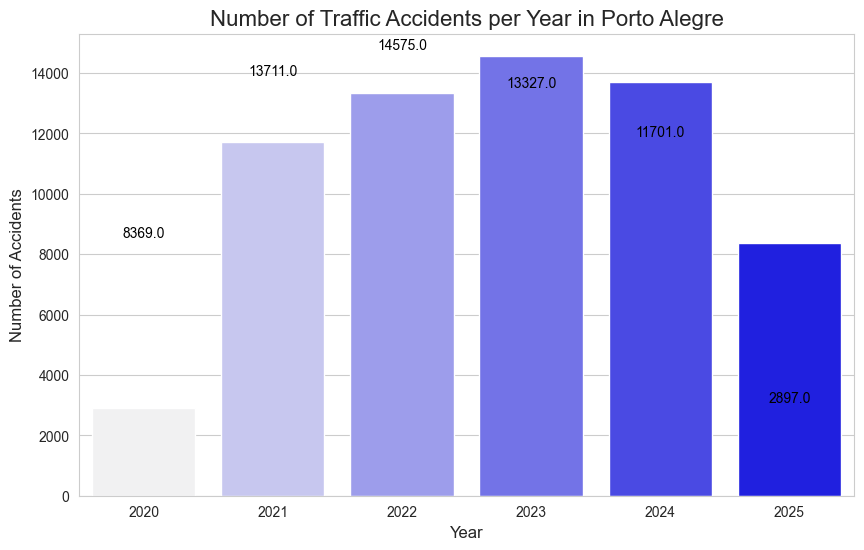

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Assuming df_year is already defined
# Convert to DataFrame for Seaborn
df_plot = df_year.reset_index()
df_plot.columns = ['Year', 'Accidents']

# Normalize for color gradient
df_plot['Grad'] = df_plot['Accidents'] / df_plot['Accidents'].max()

# Set the figure size and style
plt.figure(figsize=(10,6))
sns.set_style("whitegrid")

# Create a barplot with gradient colors
barplot = sns.barplot(
    data=df_plot,
    x='Year',
    y='Accidents',
    palette=sns.light_palette("blue", as_cmap=False, n_colors=len(df_plot))
)

# Add value labels on top of each bar
for index, row in df_plot.iterrows():
    barplot.text(
        index,               # x-position
        row['Accidents'] + 200,  # y-position slightly above the bar
        f"{row['Accidents']}",   # text
        color='black',
        ha="center"
    )

# Titles and labels
plt.title("Number of Traffic Accidents per Year in Porto Alegre", fontsize=16)
plt.xlabel("Year", fontsize=12)
plt.ylabel("Number of Accidents", fontsize=12)

plt.show()
